In [286]:
push!(LOAD_PATH, "../Daisho.jl/src")

6-element Vector{String}:
 "@"
 "@v#.#"
 "@stdlib"
 "../Daisho.jl/src"
 "../Daisho.jl/src"
 "../Daisho.jl/src"

In [287]:
using Daisho
using NCDatasets

In [290]:
sample_cfrad_path = "/Users/ischluesche/Documents/Grad_School/Research/julia_grib/g_alias.jl/cfrads/cfrad.20220918_100003.343_to_20220918_100007.317_N42RF-TS_AIR.nc"

"/Users/ischluesche/Documents/Grad_School/Research/julia_grib/g_alias.jl/cfrads/cfrad.20220918_100003.343_to_20220918_100007.317_N42RF-TS_AIR.nc"

In [291]:
inputds = NCDataset(sample_cfrad_path, "a")

Dataset: /Users/ischluesche/Documents/Grad_School/Research/julia_grib/g_alias.jl/cfrads/cfrad.20220918_100003.343_to_20220918_100007.317_N42RF-TS_AIR.nc
Group: /

Dimensions
   time = 360
   range = 721
   n_points = 257955
   sweep = 1
   string_length_8 = 8
   string_length_32 = 32
   status_xml_length = 1
   r_calib = 1
   frequency = 1

Variables
  volume_number  
    Attributes:
     long_name            = data_volume_index_number
     units                = 
     _FillValue           = -9999

  platform_type   (32)
    Datatype:    Char (Char)
    Dimensions:  string_length_32
    Attributes:
     long_name            = platform_type
     options              = fixed, vehicle, ship, aircraft_fore, aircraft_aft, aircraft_tail, aircraft_belly, aircraft_roof, aircraft_nose, satellite_orbit, satellite_geostat

  primary_axis   (32)
    Datatype:    Char (Char)
    Dimensions:  string_length_32
    Attributes:
     long_name            = primary_axis_of_rotation
     options          

In [292]:
xdist = []
ydist = [] 
zdist = []
max_z = []

newlats = []
newlons = [] 

function offset_latlon(lat, lon, dx, dy)


    ###This is kind of horrible but we're in a pinch here 
    ###dx and dy will be in meters so 
    dxkm = dx / 1000
    dykm = dy / 1000
    newlat = lat + (dykm / 110.574)
    newlon = lon + (dxkm / (111.320*cos(deg2rad(lat))))
    return(newlat, newlon)
end 


function closest_points(lat, lon; mode = "idx")

    dlat = map(abs, lats .- lat)
    dlon = map(abs, lons .- lon)

    mode == "idx" ? idx = 1 : idx = 2
    min_dlt = findmin(dlat)[idx]
    min_dln = findmin(dlon)[idx]
    return(min_dlt, min_dln)
end 



function cartesian(theta, phi, r)
    z = r * cos(deg2rad(phi))
    x = r * cos(deg2rad(theta)) * sin(deg2rad(phi))
    y = r * sin(deg2rad(theta)) * sin(deg2rad(phi))

    return(x,y,z)
end 

plane_lats = inputds["latitude"][:]
plane_lons = inputds["longitude"][:]


ranges = inputds["range"][:]
i = 1

for (elev, azi, ngates, alt) in zip(inputds["elevation"][:], inputds["azimuth"][:], inputds["ray_n_gates"], inputds["altitude"][:])
    
    curr_platform_lat = plane_lats[i] 
    curr_platform_lon = plane_lons[i] 

    for gate in 1:ngates
        curr_range = ranges[gate]
        x, y, z = cartesian(azi, 90-elev, curr_range)

        push!(xdist, x)
        push!(ydist, y)
        push!(zdist, z + alt)

        dlat, dlon = offset_latlon(curr_platform_lat, curr_platform_lon, x, y)
        push!(newlats, dlat)
        push!(newlons, dlon)
    end 
    i += 1
end 

In [293]:
###Grab closest pairs of points on model grid now 
model_closest_points = [] 
for (newlat, newlon) in zip(newlats, newlons) 
    push!(model_closest_points, closest_points(newlat, 360 + newlon, mode="other"))
end 

zdist = Vector{Float64}(zdist)

257955-element Vector{Float64}:
   2429.86
   2404.7914994812013
   2379.7229989624025
   2354.654502258301
   2329.585997924805
   2304.5175012207033
   2279.4490045166017
   2254.3805078125
   2229.3119958496095
   2204.243499145508
      ⋮
 -16351.77015625
 -16378.147109375
 -16404.5240625
 -16430.901015625
 -16457.27796875
 -16483.654921875
 -16510.031875
 -16536.408828125
 -16562.78578125

In [297]:
gate_model_lat_idxs = [itm[1] for itm in model_closest_points]
gate_model_lon_idxs = [itm[2] for itm in model_closest_points]


defVar(inputds, "CLOSEST_HAFS_LAT", gate_model_lat_idxs, ("n_points",))
defVar(inputds, "CLOSEST_HAFS_LON", gate_model_lon_idxs, ("n_points",))
defVar(inputds, "NEW_Z_METERS", zdist, ("n_points", ))
close(inputds)

NCDatasets.NetCDFError: NetCDF error: NetCDF: String match to name in use (NetCDF error code: -42)

In [282]:
inputds

Dataset: /Users/ischluesche/Documents/Grad_School/Research/julia_grib/g_alias.jl/cfrads/cfrad.20220918_100003.343_to_20220918_100007.317_N42RF-TS_AIR.nc
Group: /

Dimensions
   time = 360
   range = 721
   n_points = 257955
   sweep = 1
   string_length_8 = 8
   string_length_32 = 32
   status_xml_length = 1
   r_calib = 1
   frequency = 1

Variables
  volume_number  
    Attributes:
     long_name            = data_volume_index_number
     units                = 
     _FillValue           = -9999

  platform_type   (32)
    Datatype:    Char (Char)
    Dimensions:  string_length_32
    Attributes:
     long_name            = platform_type
     options              = fixed, vehicle, ship, aircraft_fore, aircraft_aft, aircraft_tail, aircraft_belly, aircraft_roof, aircraft_nose, satellite_orbit, satellite_geostat

  primary_axis   (32)
    Datatype:    Char (Char)
    Dimensions:  string_length_32
    Attributes:
     long_name            = primary_axis_of_rotation
     options          

NCDatasets.NetCDFError: NetCDF error: NetCDF: Write to read only (NetCDF error code: -37)

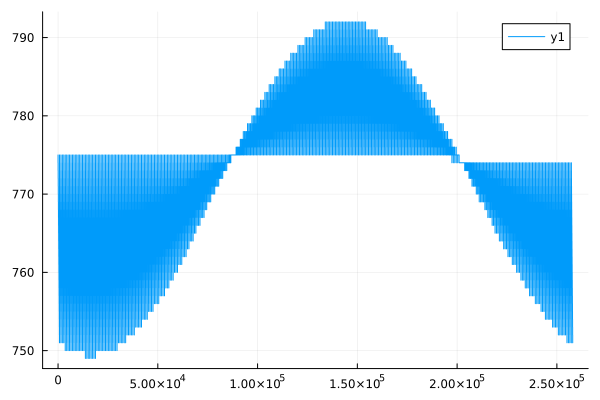

In [280]:
plot(gate_model_lon_idxs)

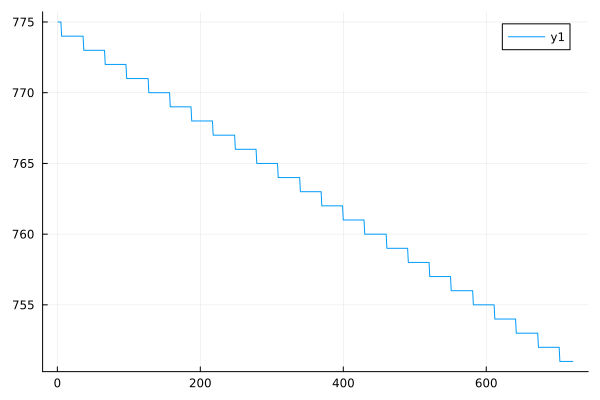

In [277]:
plot([itm[2] for itm in model_closest_points[1:721]])

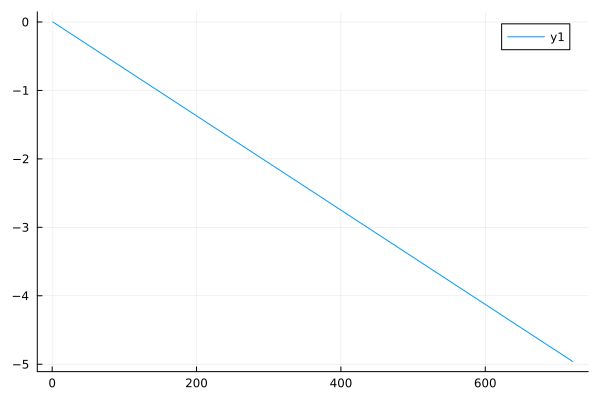

In [264]:
plot(ydist[1:721] ./ 1000)

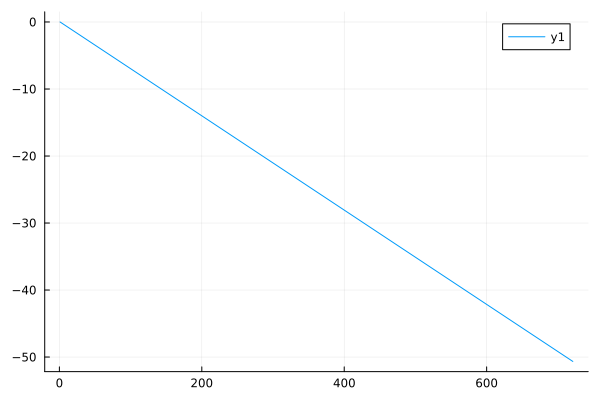

In [265]:
plot(xdist[1:721]./ 1000)

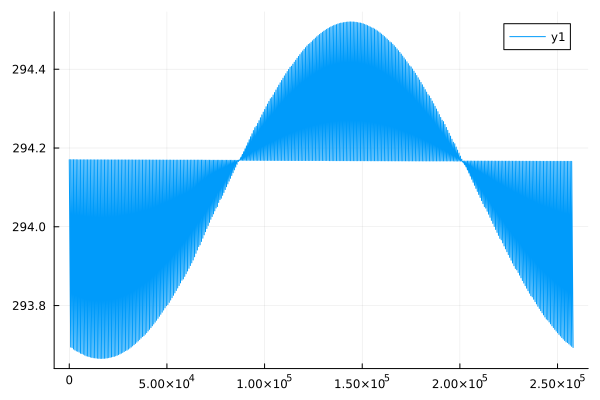

In [272]:
plot(360 .+ newlons)

In [270]:
lons

1001-element Vector{Float64}:
 278.696999
 278.716999
 278.73699899999997
 278.75699899999995
 278.77699899999993
 278.7969989999999
 278.8169989999999
 278.8369989999999
 278.85699899999986
 278.87699899999984
   ⋮
 298.53699899998196
 298.55699899998194
 298.5769989999819
 298.5969989999819
 298.6169989999819
 298.63699899998187
 298.65699899998185
 298.67699899998183
 298.696999

In [258]:
cartesian(0, 90, max_range)

(54000.0, 0.0, 3.3065463576978536e-12)

In [259]:
offset_latlon

offset_latlon (generic function with 1 method)

In [254]:
inputds["range"]

range (721)
  Datatype:    Float32 (Float32)
  Dimensions:  range
  Attributes:
   long_name            = range_to_center_of_measurement_volume
   standard_name        = projection_range_coordinate
   units                = meters
   axis                 = radial_range_coordinate
   spacing_is_constant  = true
   meters_to_center_of_first_gate = 0.0
   meters_between_gates = 75.00000298023224


In [252]:
inputds["azimuth"][:]

360-element Vector{Union{Missing, Float32}}:
 185.59212f0
 185.63959f0
 185.76285f0
 185.84146f0
 185.9082f0
 185.94159f0
 185.97366f0
 186.05476f0
 186.07939f0
 186.1217f0
   ⋮
 184.36707f0
 184.53236f0
 184.68817f0
 184.83481f0
 184.90352f0
 185.03429f0
 185.15916f0
 185.27556f0
 185.38347f0

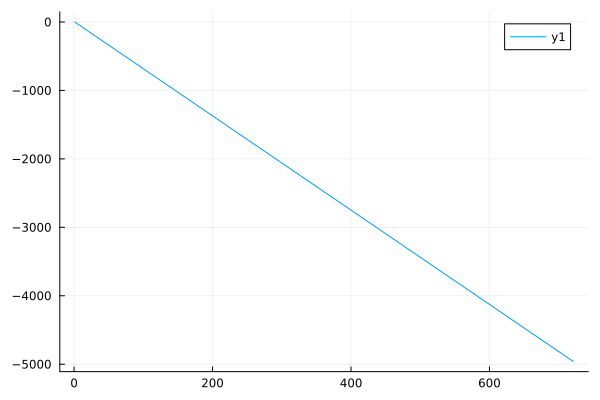

In [248]:
plot(ydist[1:721])

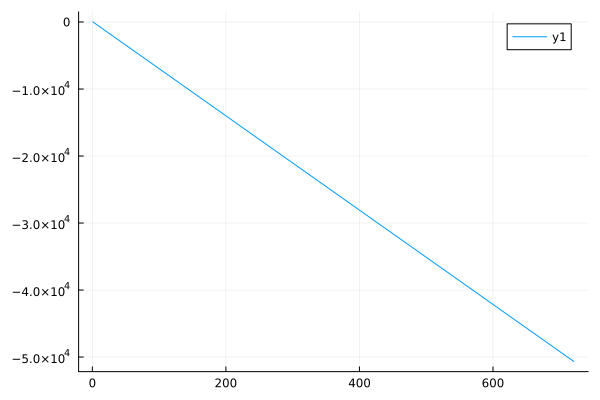

In [249]:
plot(xdist[1:721])

In [244]:

for i in 1:720
    offset_latlon
end 

In [245]:
ranges[70]

5175.0f0

In [242]:
j = 0 
for gate in 1:ngates
    j +=1
end

MethodError: MethodError: no method matching (::Colon)(::Int64, ::Vector{Union{Missing, Int32}})

Closest candidates are:
  (::Colon)(::A, ::Any, !Matched::C) where {A<:Real, C<:Unitful.Quantity}
   @ Unitful ~/.julia/packages/Unitful/GYzMo/src/range.jl:86
  (::Colon)(::T, ::Any, !Matched::T) where T<:Real
   @ Base range.jl:50
  (::Colon)(::A, ::Any, !Matched::C) where {A<:Real, C<:Real}
   @ Base range.jl:10
  ...


In [237]:
ranges

721-element Vector{Float32}:
     0.0
    75.0
   150.0
   225.0
   300.0
   375.0
   450.0
   525.0
   600.0
   675.0
     ⋮
 53400.0
 53475.0
 53550.0
 53625.0
 53700.0
 53775.0
 53850.0
 53925.0
 54000.0

In [236]:
newlats

257955-element Vector{Any}:
 16.927668945863843
 16.927606651809725
 16.927544357755608
 16.92748206370149
 16.927419769647372
 16.927357475626945
 16.927295181539133
 16.927232887518706
 16.927170593430898
 16.92710829941047
  ⋮
 16.887149103046333
 16.887089536134887
 16.88702996491106
 16.886970393687232
 16.886910822463406
 16.8868512469272
 16.886791680015754
 16.886732108791925
 16.88667253325572

In [198]:
x=2
x +=1 

3

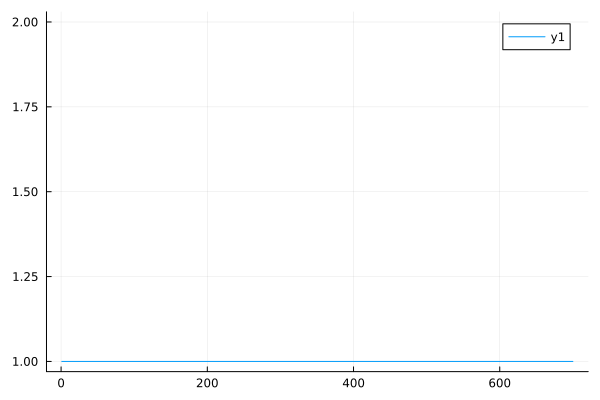

In [238]:
plot([itm[2] for itm in model_closest_points[1:700]])

In [235]:
lats

801-element Vector{Float64}:
 14.827
 14.846999
 14.866998
 14.886997000000001
 14.906996000000001
 14.926995000000002
 14.946994000000002
 14.966993000000002
 14.986992000000003
 15.006991000000003
  ⋮
 30.666207999998953
 30.68620699999895
 30.70620599999895
 30.72620499999895
 30.746203999998947
 30.766202999998946
 30.786201999998944
 30.806200999998943
 30.827

In [200]:
for i in 1:250 
    closest_points(20, 287)
end 

In [215]:
lons

1001-element Vector{Float64}:
 278.696999
 278.716999
 278.73699899999997
 278.75699899999995
 278.77699899999993
 278.7969989999999
 278.8169989999999
 278.8369989999999
 278.85699899999986
 278.87699899999984
   ⋮
 298.53699899998196
 298.55699899998194
 298.5769989999819
 298.5969989999819
 298.6169989999819
 298.63699899998187
 298.65699899998185
 298.67699899998183
 298.696999

In [183]:
map(abs, lats .- 20)

801-element Vector{Float64}:
  5.173
  5.153001
  5.133001999999999
  5.113002999999999
  5.093003999999999
  5.073004999999998
  5.053005999999998
  5.033006999999998
  5.0130079999999975
  4.993008999999997
  ⋮
 10.666207999998953
 10.686206999998952
 10.70620599999895
 10.726204999998949
 10.746203999998947
 10.766202999998946
 10.786201999998944
 10.806200999998943
 10.827000000000002

In [ ]:
###Let's conver these to a lat/lon 

In [154]:
hafs_ds = Dataset("testout.nc")

Dataset: testout.nc
Group: /

Dimensions
   time = 1
   level = 45
   lat = 801
   lon = 1001

Variables
  time   (1)
    Datatype:    Dates.DateTime (Float64)
    Dimensions:  time
    Attributes:
     units                = days since 1900-01-01 00:00:00

  level   (45)
    Datatype:    Int64 (Int64)
    Dimensions:  level

  lat   (801)
    Datatype:    Float64 (Float64)
    Dimensions:  lat

  lon   (1001)
    Datatype:    Float64 (Float64)
    Dimensions:  lon

  u   (1001 × 801 × 45 × 1)
    Datatype:    Union{Missing, Float64} (Float64)
    Dimensions:  lon × lat × level × time
    Attributes:
     _FillValue           = 9.969209968386869e36

  v   (1001 × 801 × 45 × 1)
    Datatype:    Union{Missing, Float64} (Float64)
    Dimensions:  lon × lat × level × time
    Attributes:
     _FillValue           = 9.969209968386869e36

  w   (1001 × 801 × 45 × 1)
    Datatype:    Union{Missing, Float64} (Float64)
    Dimensions:  lon × lat × level × time
    Attributes:
     _FillValue   

In [172]:
hafs_ds["u"][:,:,:]

1001×801×45 Array{Union{Missing, Float64}, 3}:
[:, :, 1] =
 missing  missing  missing  missing  …  missing  missing  missing  missing
 missing  missing  missing  missing     missing  missing  missing  missing
 missing  missing  missing  missing     missing  missing  missing  missing
 missing  missing  missing  missing     missing  missing  missing  missing
 missing  missing  missing  missing     missing  missing  missing  missing
 missing  missing  missing  missing  …  missing  missing  missing  missing
 missing  missing  missing  missing     missing  missing  missing  missing
 missing  missing  missing  missing     missing  missing  missing  missing
 missing  missing  missing  missing     missing  missing  missing  missing
 missing  missing  missing  missing     missing  missing  missing  missing
 ⋮                                   ⋱                             ⋮
 missing  missing  missing  missing     missing  missing  missing  missing
 missing  missing  missing  missing     missing

In [167]:
levs = hafs_ds["level"][:]
lats = hafs_ds["lat"][:]
lons = hafs_ds["lon"][:]

1001-element Vector{Float64}:
 278.696999
 278.716999
 278.73699899999997
 278.75699899999995
 278.77699899999993
 278.7969989999999
 278.8169989999999
 278.8369989999999
 278.85699899999986
 278.87699899999984
   ⋮
 298.53699899998196
 298.55699899998194
 298.5769989999819
 298.5969989999819
 298.6169989999819
 298.63699899998187
 298.65699899998185
 298.67699899998183
 298.696999

In [168]:

points = hcat(lons, lats, levs)'

DimensionMismatch: DimensionMismatch: mismatch in dimension 1 (expected 1001 got 801)

In [176]:
using Dierckx

In [178]:
Spline2D

Spline2D

In [173]:
Pkg.add("Dierckx")

In [169]:
points = hcat(xs, ys, zs)'


3×31 adjoint(::Matrix{Float64}) with eltype Float64:
 187.0  313.0  157.0  343.0  132.0  …  250.0  180.0  320.0  118.0  382.0
  57.0   57.0  134.0  134.0  250.0     475.0  466.0  466.0  433.0  433.0
  57.0   57.0  134.0  134.0  250.0     475.0  466.0  466.0  433.0  433.0

In [170]:
[lats lons levs]

DimensionMismatch: DimensionMismatch: mismatch in dimension 1 (expected 801 got 1001)

In [165]:
using ScatteredInterpolation

xs = [187.0, 313.0, 157.0, 343.0, 132.0, 368.0, 157.0, 343.0, 187.0, 313.0, 85.0, 415.0, 46.0, 454.0, 85.0, 415.0, 250.0, 250.0, 57.0, 443.0, 129.0, 371.0, 164.0, 336.0, 250.0, 250.0, 250.0, 180.0, 320.0, 118.0, 382.0]
ys = [57.0, 57.0, 134.0, 134.0, 250.0, 250.0, 366.0, 366.0, 443.0, 443.0, 129.0, 129.0, 250.0, 250.0, 371.0, 371.0, 132.0, 368.0, 313.0, 313.0, 415.0, 415.0, 403.0, 403.0, 417.0, 454.0, 475.0, 466.0, 466.0, 433.0, 433.0] 
zs = [57.0, 57.0, 134.0, 134.0, 250.0, 250.0, 366.0, 366.0, 443.0, 443.0, 129.0, 129.0, 250.0, 250.0, 371.0, 371.0, 132.0, 368.0, 313.0, 313.0, 415.0, 415.0, 403.0, 403.0, 417.0, 454.0, 475.0, 466.0, 466.0, 433.0, 433.0] 
samples = [-19.995152, -46.38638, -28.329832, 81.12224, -67.002556, 21.798035, 32.538525, 38.022156, -14.682513, -56.849937, -20.680933, 95.41259, 22.357513, 36.404854, -37.628937, -3.4352758, -25.271269, 36.05853, 26.666668, -29.088951, -7.4670925, -47.769047, -29.178823, -43.958958, 29.638771, -10.448129, 5.71033, -25.612432, 37.268364, -22.657557, -2.0058606]

points = hcat(xs, ys, zs)'

itp = interpolate(NearestNeighbor(), points, samples)
interpolated = evaluate(itp, [187.0, 57.0, 57.0]) # evaluate it for how ever many coordinates that you want

1×1 Matrix{Float64}:
 -19.995152

In [162]:
size(samples)

(31,)

In [159]:
points

2×31 adjoint(::Matrix{Float64}) with eltype Float64:
 187.0  313.0  157.0  343.0  132.0  …  250.0  180.0  320.0  118.0  382.0
  57.0   57.0  134.0  134.0  250.0     475.0  466.0  466.0  433.0  433.0

In [157]:
import Pkg; Pkg.add("ScatteredInterpolation")

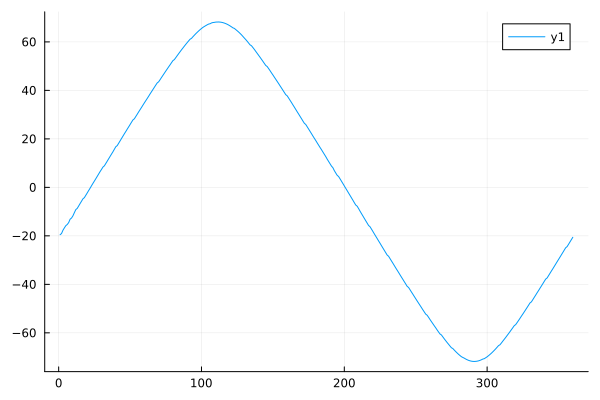

In [151]:
plot(inputds["elevation"][:])

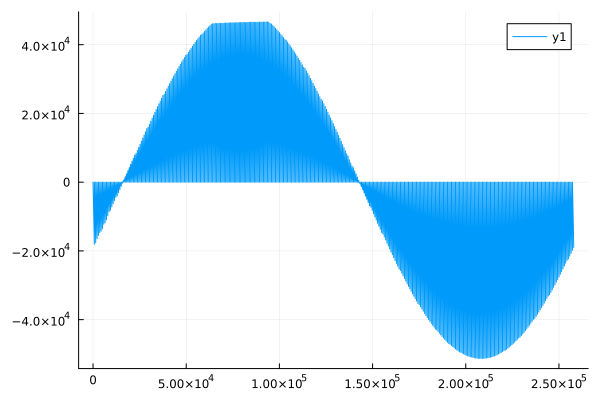

In [152]:
plot(zdist)

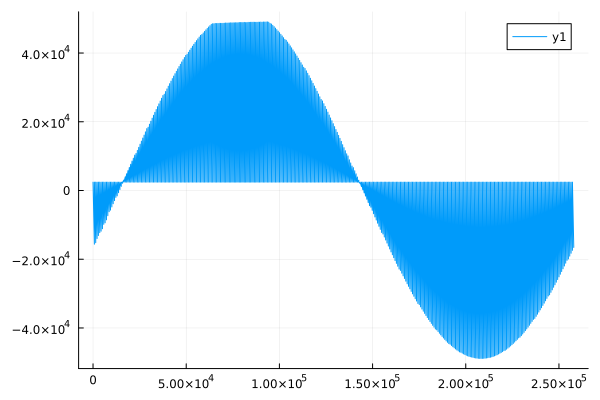

In [146]:
plot(zdist)

In [ ]:
###Now we need to convert these distances to latitude/longitude coordinates 

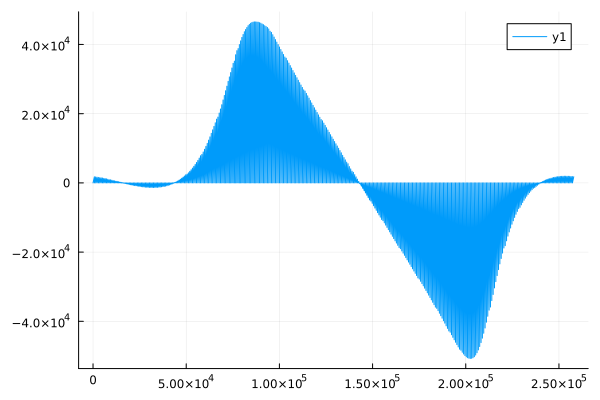

In [116]:
plot(xdist)


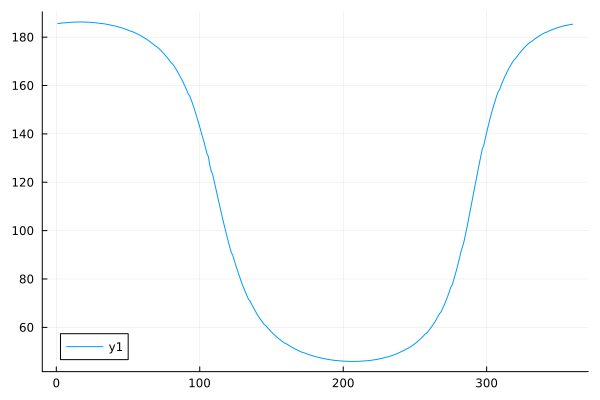

In [105]:
cartesian(-19.52, 185.59, 1)

0.032547908479261964

In [85]:
deg2rad

deg2rad (generic function with 6 methods)

In [87]:
cos(deg2rad(180))

-1.0

cartesian (generic function with 1 method)

In [77]:
inputds["range"][:]

721-element Vector{Float32}:
     0.0
    75.0
   150.0
   225.0
   300.0
   375.0
   450.0
   525.0
   600.0
   675.0
     ⋮
 53400.0
 53475.0
 53550.0
 53625.0
 53700.0
 53775.0
 53850.0
 53925.0
 54000.0

In [75]:
inputds

Dataset: /Users/ischluesche/Documents/Grad_School/Research/julia_grib/g_alias.jl/cfrads/cfrad.20220918_100003.343_to_20220918_100007.317_N42RF-TS_AIR.nc
Group: /

Dimensions
   time = 360
   range = 721
   n_points = 257955
   sweep = 1
   string_length_8 = 8
   string_length_32 = 32
   status_xml_length = 1
   r_calib = 1
   frequency = 1

Variables
  volume_number  
    Attributes:
     long_name            = data_volume_index_number
     units                = 
     _FillValue           = -9999

  platform_type   (32)
    Datatype:    Char (Char)
    Dimensions:  string_length_32
    Attributes:
     long_name            = platform_type
     options              = fixed, vehicle, ship, aircraft_fore, aircraft_aft, aircraft_tail, aircraft_belly, aircraft_roof, aircraft_nose, satellite_orbit, satellite_geostat

  primary_axis   (32)
    Datatype:    Char (Char)
    Dimensions:  string_length_32
    Attributes:
     long_name            = primary_axis_of_rotation
     options          

In [68]:
inputds["ray_n_gates"][:]

360-element Vector{Union{Missing, Int32}}:
 721
 721
 721
 721
 721
 721
 721
 721
 721
 721
   ⋮
 721
 721
 721
 721
 721
 721
 721
 721
 721

In [69]:
360 * 721

259560

In [67]:
i

92863801

In [50]:
elevs = inputds["elevation"]

elevation (360)
  Datatype:    Union{Missing, Float32} (Float32)
  Dimensions:  time
  Attributes:
   long_name            = ray_elevation_angle
   units                = degrees
   _FillValue           = -9999.0
   positive             = up


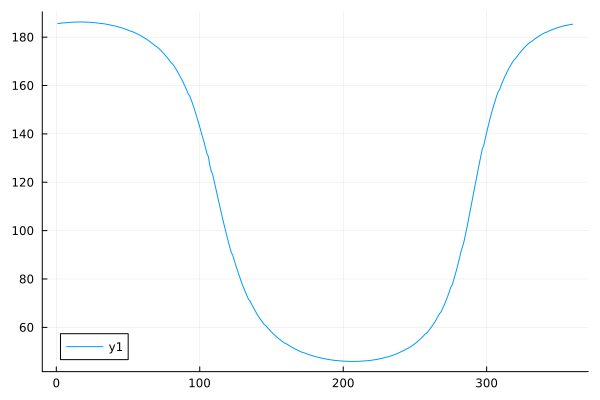

In [41]:
plot(azis)

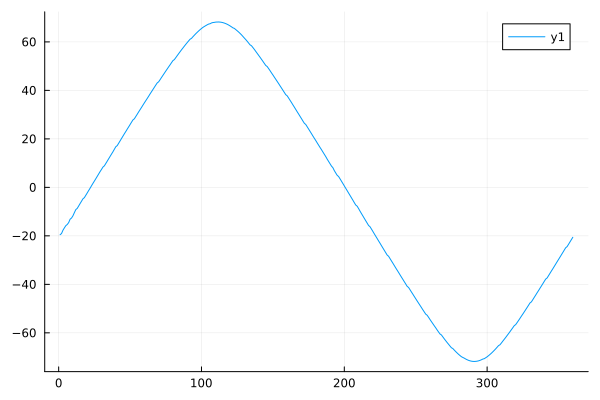

In [11]:
plot(eldata)

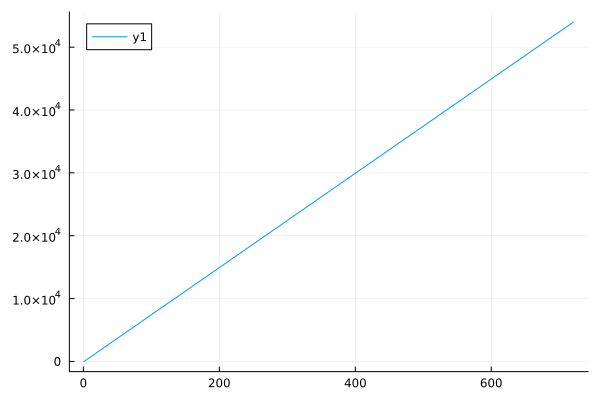

In [12]:
plot(rangedata)

In [26]:
inputds["sweep_end_ray_index"][:]

1-element Vector{Union{Missing, Int32}}:
 359

In [23]:
360*717

257760

In [32]:
ngates = inputds["ray_n_gates"][:]

360-element Vector{Union{Missing, Int32}}:
 721
 721
 721
 721
 721
 721
 721
 721
 721
 721
   ⋮
 721
 721
 721
 721
 721
 721
 721
 721
 721

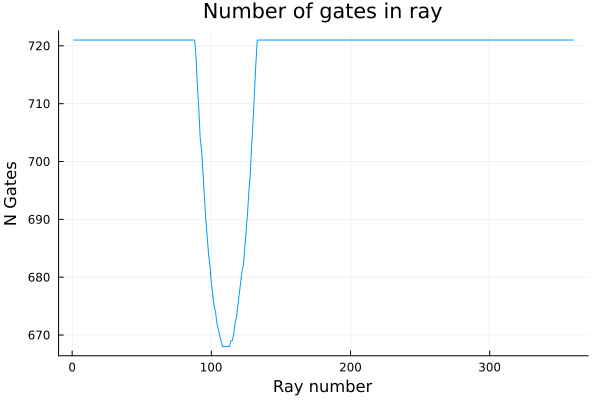

In [34]:
plot(ngates, title="Number of gates in ray", ylabel="N Gates", xlabel="Ray number", legend=:none)

In [8]:
using Plots

In [10]:
plot(londata)

UndefVarError: UndefVarError: `londata` not defined

In [17]:
Daisho.read_cfradial(sample_cfrad_path, moments)

MethodError: MethodError: no method matching getindex(::NCDataset{Nothing, Missing}, ::Int64)

Closest candidates are:
  getindex(::CommonDataModel.AbstractDataset, !Matched::Union{AbstractString, Symbol})
   @ CommonDataModel ~/.julia/packages/CommonDataModel/vTYnt/src/dataset.jl:169
  getindex(::Union{CommonDataModel.AbstractDataset, CommonDataModel.AbstractVariable}, !Matched::CommonDataModel.CFStdName)
   @ CommonDataModel ~/.julia/packages/CommonDataModel/vTYnt/src/dataset.jl:246


In [23]:
longitude = inputds["longitude"]
    londata = longitude[:]

    altitude = inputds["altitude"]
    altdata = altitude[:]
    
    fixed_angle = inputds["fixed_angle"]
    angledata = fixed_angle[:]

    sweep_start = inputds["sweep_start_ray_index"]
    swpstart = sweep_start[:]
    
    sweep_end = inputds["sweep_end_ray_index"]
    swpend = sweep_end[:]

1-element Vector{Union{Missing, Int32}}:
 359

In [43]:
inputds

Dataset: /Users/ischluesche/Documents/Grad_School/Research/julia_grib/g_alias.jl/cfrads/cfrad.20220918_100003.343_to_20220918_100007.317_N42RF-TS_AIR.nc
Group: /

Dimensions
   time = 360
   range = 721
   n_points = 257955
   sweep = 1
   string_length_8 = 8
   string_length_32 = 32
   status_xml_length = 1
   r_calib = 1
   frequency = 1

Variables
  volume_number  
    Attributes:
     long_name            = data_volume_index_number
     units                = 
     _FillValue           = -9999

  platform_type   (32)
    Datatype:    Char (Char)
    Dimensions:  string_length_32
    Attributes:
     long_name            = platform_type
     options              = fixed, vehicle, ship, aircraft_fore, aircraft_aft, aircraft_tail, aircraft_belly, aircraft_roof, aircraft_nose, satellite_orbit, satellite_geostat

  primary_axis   (32)
    Datatype:    Char (Char)
    Dimensions:  string_length_32
    Attributes:
     long_name            = primary_axis_of_rotation
     options          

In [46]:
n_points = inputds.dim["n_points"]
#If number of gates vary then dimension is smaller
if true
   moment_dim = n_points
end

257955

In [47]:
n_moments = length(moments)
radardata = Array{Union{Missing, Float32}}(undef,n_points,n_moments)



257955×2 Matrix{Union{Missing, Float32}}:
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 ⋮        
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing
 missing  missing

In [48]:
moment_dict = Dict(1 => "DBZ", 2=> "VEL")

Dict{Int64, String} with 2 entries:
  2 => "VEL"
  1 => "DBZ"

In [54]:
scan_name = inputds.attrib["scan_name"]
    
    az = inputds["azimuth"]
    azdata = az[:]
    
    el = inputds["elevation"]
    eldata = el[:]
    
    range = inputds["range"]
    rangedata = range[:]
    
    time = inputds["time"]
    timedata = time[:]

    latitude = inputds["latitude"]
    latdata = latitude[:]
    
    longitude = inputds["longitude"]
    londata = longitude[:]

    altitude = inputds["altitude"]
    altdata = altitude[:]
    
    fixed_angle = inputds["fixed_angle"]
    angledata = fixed_angle[:]

    sweep_start = inputds["sweep_start_ray_index"]
    swpstart = sweep_start[:]
    
    sweep_end = inputds["sweep_end_ray_index"]
    swpend = sweep_end[:]

1-element Vector{Union{Missing, Int32}}:
 359

In [49]:
keys(moment_dict)

KeySet for a Dict{Int64, String} with 2 entries. Keys:
  2
  1

In [50]:
for key in keys(moment_dict)
    radardata[:, key] = inputds[moment_dict[key]][:]
end


In [30]:
moments[key]

UndefVarError: UndefVarError: `key` not defined

In [28]:
for key in keys(moments)
    print(key)
end

12

In [56]:
radar_obj = Daisho.radar(scan_name, azdata, eldata, rangedata, timedata, latdata, londata, altdata, angledata, swpstart, swpend, radardata)

Daisho.radar("SL-90", Union{Missing, Float32}[185.59212f0, 185.63959f0, 185.76285f0, 185.84146f0, 185.9082f0, 185.94159f0, 185.97366f0, 186.05476f0, 186.07939f0, 186.1217f0  …  184.19243f0, 184.36707f0, 184.53236f0, 184.68817f0, 184.83481f0, 184.90352f0, 185.03429f0, 185.15916f0, 185.27556f0, 185.38347f0], Union{Missing, Float32}[-19.526737f0, -19.040987f0, -17.67806f0, -16.713097f0, -15.794684f0, -15.3131075f0, -14.530967f0, -13.13169f0, -12.652221f0, -11.71697f0  …  -28.783422f0, -27.81999f0, -26.852867f0, -25.884674f0, -24.915478f0, -24.439484f0, -23.489412f0, -22.520582f0, -21.553537f0, -20.590906f0], Union{Missing, Float32}[0.0f0, 75.0f0, 150.0f0, 225.0f0, 300.0f0, 375.0f0, 450.0f0, 525.0f0, 600.0f0, 675.0f0  …  53325.0f0, 53400.0f0, 53475.0f0, 53550.0f0, 53625.0f0, 53700.0f0, 53775.0f0, 53850.0f0, 53925.0f0, 54000.0f0], [Dates.DateTime("2022-09-18T10:00:03.343"), Dates.DateTime("2022-09-18T10:00:03.349"), Dates.DateTime("2022-09-18T10:00:03.366"), Dates.DateTime("2022-09-18T10:00

In [57]:
rangedata

721-element Vector{Float32}:
     0.0
    75.0
   150.0
   225.0
   300.0
   375.0
   450.0
   525.0
   600.0
   675.0
     ⋮
 53400.0
 53475.0
 53550.0
 53625.0
 53700.0
 53775.0
 53850.0
 53925.0
 54000.0

In [74]:
grid = Daisho.initialize_regular_grid(0, 2000, 1001, 0, 2000, 801, 0, 1000, 45)

45×801×1001×3 Array{Float64, 4}:
[:, :, 1, 1] =
     0.0      0.0      0.0      0.0  …      0.0      0.0      0.0      0.0
  1000.0   1000.0   1000.0   1000.0      1000.0   1000.0   1000.0   1000.0
  2000.0   2000.0   2000.0   2000.0      2000.0   2000.0   2000.0   2000.0
  3000.0   3000.0   3000.0   3000.0      3000.0   3000.0   3000.0   3000.0
  4000.0   4000.0   4000.0   4000.0      4000.0   4000.0   4000.0   4000.0
  5000.0   5000.0   5000.0   5000.0  …   5000.0   5000.0   5000.0   5000.0
  6000.0   6000.0   6000.0   6000.0      6000.0   6000.0   6000.0   6000.0
  7000.0   7000.0   7000.0   7000.0      7000.0   7000.0   7000.0   7000.0
  8000.0   8000.0   8000.0   8000.0      8000.0   8000.0   8000.0   8000.0
  9000.0   9000.0   9000.0   9000.0      9000.0   9000.0   9000.0   9000.0
     ⋮                               ⋱                                 ⋮
 36000.0  36000.0  36000.0  36000.0     36000.0  36000.0  36000.0  36000.0
 37000.0  37000.0  37000.0  37000.0     37000.0  37000

In [75]:
radar_grid, latlon_grid = Daisho.grid_volume(20., -80., grid, radar_obj, moment_dict, 1.5, .75, 0.)

([-32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; … ;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; … ;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;; -32768.0 -32768.0 … -32768.0 -32768.0; -32768.0 -32768.0 … -32768.0 -32768.0;;;; -32768.0 -32768.0 … -327

In [76]:
size(radar_grid)

(2, 45, 801, 1001)

In [77]:
size(latlon_grid)

(801, 1001, 2)

In [78]:
latlon_grid[:,:,1]

801×1001 Matrix{Float64}:
 20.0     20.0     20.0     20.0     …  19.0187  19.0168  19.0149  19.013
 20.0181  20.0181  20.0181  20.0181     19.0358  19.0339  19.032   19.0301
 20.0361  20.0361  20.0361  20.0361     19.0529  19.051   19.0491  19.0472
 20.0542  20.0542  20.0542  20.0542     19.07    19.0681  19.0662  19.0644
 20.0723  20.0723  20.0723  20.0723     19.0871  19.0853  19.0834  19.0815
 20.0903  20.0903  20.0903  20.0903  …  19.1043  19.1024  19.1005  19.0986
 20.1084  20.1084  20.1084  20.1084     19.1214  19.1195  19.1176  19.1157
 20.1265  20.1265  20.1265  20.1265     19.1385  19.1366  19.1347  19.1328
 20.1445  20.1445  20.1445  20.1445     19.1556  19.1537  19.1518  19.1499
 20.1626  20.1626  20.1626  20.1626     19.1727  19.1708  19.1689  19.167
  ⋮                                  ⋱                              ⋮
 34.2948  34.2948  34.2948  34.2948     32.4744  32.4709  32.4675  32.464
 34.3129  34.3129  34.3129  34.3128     32.4913  32.4878  32.4843  32.4808
 34.330

In [79]:
latlon_grid[:,:,2]

801×1001 Matrix{Float64}:
 -80.0  -79.9809  -79.9618  -79.9427  …  -61.3084  -61.2904  -61.2724
 -80.0  -79.9809  -79.9618  -79.9427     -61.3064  -61.2884  -61.2704
 -80.0  -79.9809  -79.9618  -79.9427     -61.3044  -61.2864  -61.2684
 -80.0  -79.9809  -79.9618  -79.9426     -61.3024  -61.2844  -61.2664
 -80.0  -79.9809  -79.9618  -79.9426     -61.3004  -61.2824  -61.2644
 -80.0  -79.9809  -79.9618  -79.9426  …  -61.2984  -61.2804  -61.2624
 -80.0  -79.9809  -79.9618  -79.9426     -61.2964  -61.2784  -61.2604
 -80.0  -79.9809  -79.9617  -79.9426     -61.2944  -61.2764  -61.2584
 -80.0  -79.9809  -79.9617  -79.9426     -61.2924  -61.2744  -61.2564
 -80.0  -79.9809  -79.9617  -79.9426     -61.2904  -61.2724  -61.2544
   ⋮                                  ⋱                        ⋮
 -80.0  -79.9783  -79.9566  -79.9348     -58.9654  -58.9455  -58.9257
 -80.0  -79.9783  -79.9565  -79.9348     -58.9613  -58.9414  -58.9215
 -80.0  -79.9783  -79.9565  -79.9348     -58.9571  -58.9373  -58.9174

In [70]:
Daisho.write_gridded_radar_volume("ok.out", radar_obj.time[1], radar_obj.time[end], grid, radar_grid, latlon_grid, moment_dict, 20., -80.)

KeyError: KeyError: key 2 not found

In [68]:
radar_obj.time[end]

2022-09-18T10:00:07.317

In [64]:
Float64 <: AbstractFloat

true

In [58]:
hafs_file = Dataset("testout.nc")

Dataset: testout.nc
Group: /

Dimensions
   time = 1
   level = 45
   lat = 801
   lon = 1001

Variables
  time   (1)
    Datatype:    Dates.DateTime (Float64)
    Dimensions:  time
    Attributes:
     units                = days since 1900-01-01 00:00:00

  level   (45)
    Datatype:    Int64 (Int64)
    Dimensions:  level

  lat   (801)
    Datatype:    Float64 (Float64)
    Dimensions:  lat

  lon   (1001)
    Datatype:    Float64 (Float64)
    Dimensions:  lon

  u   (1001 × 801 × 45 × 1)
    Datatype:    Union{Missing, Float64} (Float64)
    Dimensions:  lon × lat × level × time
    Attributes:
     _FillValue           = 9.969209968386869e36

  v   (1001 × 801 × 45 × 1)
    Datatype:    Union{Missing, Float64} (Float64)
    Dimensions:  lon × lat × level × time
    Attributes:
     _FillValue           = 9.969209968386869e36

  w   (1001 × 801 × 45 × 1)
    Datatype:    Union{Missing, Float64} (Float64)
    Dimensions:  lon × lat × level × time
    Attributes:
     _FillValue   